## WaveFront OBJ CAD File Read in / Display in Python

### taken from:
- https://chart-studio.plotly.com/~empet/14749/mesh3d-with-intensities-and-flatshading/#/

In [1]:
import plotly
import plotly.graph_objects as go
import plotly.express as px
import numpy as np
import pandas as pd

import stl

In [2]:
# Define a path to the PMS Canister WaveFront Obj
pmsfile = "/Users/jrobrien/Dissertation/data/pmsCanister/pmsCanister_v4.stl"

In [3]:
# Define the ECOR STL CAD file
ecorfile = "/Users/jrobrien/Dissertation/data/CAD_files/ECOR_Mount_v2.stl"

## Try plotting with Numpy-STL / Matplotlib 3D 

In [4]:
from stl import mesh
from mpl_toolkits import mplot3d
import matplotlib.pyplot as plt

# Create a new plot
#figure = plt.figure()
#axes = mplot3d.Axes3D(figure)

# Load the STL files and add the vectors to the plot
pmsMesh = mesh.Mesh.from_file(pmsfile)

## Use Plotly for the 3D graphics 

In [5]:
## taken from: 
## https://stackoverflow.com/questions/71929869/how-could-i-efficiently-get-the-closest-points-on-the-surface-of-my-model
def stl2mesh3d(stl_mesh):
    # stl_mesh is read by numpy-stl from a stl file; it is  an array of faces/triangles (i.e. three 3d points) 
    # this function extracts the unique vertices and the lists I, J, K to define a Plotly mesh3d
    p, q, r = stl_mesh.vectors.shape #(p, 3, 3)
    # the array stl_mesh.vectors.reshape(p*q, r) can contain multiple copies of the same vertex;
    # extract unique vertices from all mesh triangles
    vertices, ixr = np.unique(stl_mesh.vectors.reshape(p*q, r), return_inverse=True, axis=0)
    I = np.take(ixr, [3*k for k in range(p)])
    J = np.take(ixr, [3*k+1 for k in range(p)])
    K = np.take(ixr, [3*k+2 for k in range(p)])
    return vertices, I, J, K

In [6]:
vertices, I, J, K = stl2mesh3d(pmsMesh)
x, y, z = vertices.T

In [7]:
# https://plotly.github.io/plotly.py-docs/generated/plotly.graph_objects.Mesh3d.html
mesh3d = go.Mesh3d(
    x=(x/1000.),
    y=(y/1000.),
    z=(z/1000.), 
    i=I, 
    j=J, 
    k=K, 
    name = "mesh",
    color='gold',
#    showscale=False,
#    showlegend = True,
#     colorscale=[[0, '#e5dee5'], [1, 'red']], 
#    colorscale = "thermal",
#    colorbar_x=-0.1,
#    flatshading=True,
#    lighting=dict(
#        ambient= 0.18,
#        diffuse= 1,
#        fresnel=  .1,
#        specular= 1,
#        roughness= .1,
#        facenormalsepsilon=0
#    ),
#    lightposition=dict(
#        x=3000,
#        y=3000,
#        z=10000
#    )
)


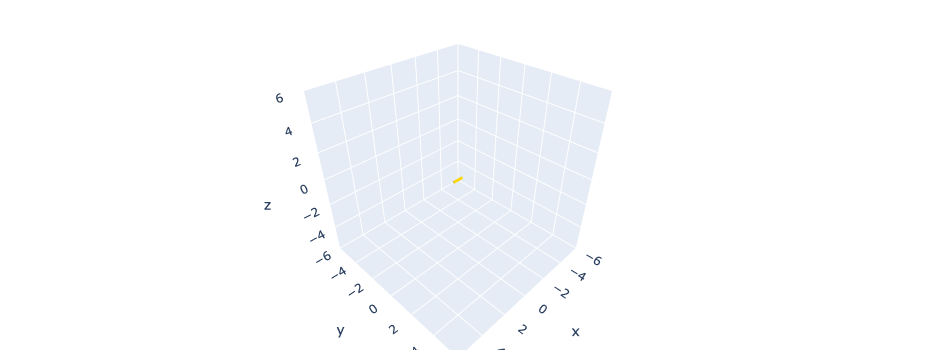

In [8]:
fig = go.Figure(mesh3d)

fig.update_layout(
    scene = dict(
        xaxis = dict(nticks=9, range=[-6, 6],),
                     yaxis = dict(nticks=9, range=[-6, 6],),
                     zaxis = dict(nticks=9, range=[-6, 6],),),
    width=700,
    margin=dict(r=20, l=10, b=10, t=10))

#fig.update_layout(xaxis=dict(range=[-40, 40]))
#fig.update_layout(zaxis_range=[-400, 400])
#fig.show()

## Okay! That looks good! Let's add Particle Tracks 

In [9]:
# Define the particle track file
npar = "/Users/jrobrien/Dissertation/data/pmsCanister/pmsCanister_v8_tas120_aoa0_900T30_part10_LPT.csv"

In [10]:
df = pd.read_csv(npar)

In [11]:
df

,active,origId,typeId,origProcId,d,rho,dTarget,nParticle,age,tTurb,...,UTurb:1,UTurb:2,U:0,U:1,U:2,Points:0,Points:1,Points:2,Point ID,Block Number
0,1,0,-1,0,0.00001,1000,0,1,2.65242,0,...,0,0,120.000,-0.003043,0.000009,-7.499980,-0.210059,-0.010000,0,2
1,1,0,-1,0,0.00001,1000,0,1,2.67325,0,...,0,0,119.997,-0.003273,0.000027,-4.999960,-0.210124,-0.010000,1,2
2,1,0,-1,0,0.00001,1000,0,1,2.69409,0,...,0,0,119.972,-0.006725,0.000036,-2.499880,-0.210207,-0.009999,2,2
3,1,0,-1,0,0.00001,1000,0,1,2.70765,0,...,0,0,119.404,-0.249169,-0.012199,-0.874616,-0.210750,-0.010020,3,2
4,1,0,-1,0,0.00001,1000,0,1,2.71080,0,...,0,0,117.916,-2.855460,-0.157646,-0.499496,-0.213683,-0.010177,4,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
736596,1,49999,-1,0,0.00001,1000,0,1,2.71802,0,...,0,0,120.542,0.387588,-0.885457,0.374780,-0.186617,0.407256,736596,2
736597,1,49999,-1,0,0.00001,1000,0,1,2.72324,0,...,0,0,119.757,0.081991,-0.283205,0.999701,-0.185282,0.403753,736597,2
736598,1,49999,-1,0,0.00001,1000,0,1,2.73992,0,...,0,0,119.910,0.016018,-0.031066,2.999910,-0.184592,0.402324,736598,2
736599,1,49999,-1,0,0.00001,1000,0,1,2.76077,0,...,0,0,119.922,0.013994,-0.024957,5.499970,-0.184081,0.401469,736599,2


In [12]:
# Subset dataset to just the particles around the canister
df2 = df[(df["Points:0"] > -1.0) & (df["Points:0"] < 0.0) & (df["Points:1"] > -2) & (df["Points:1"] < 2) & (df["Points:2"] > -0.5) & (df["Points:2"] < 0.5)]

In [13]:
vel = df2['U:0'].copy()

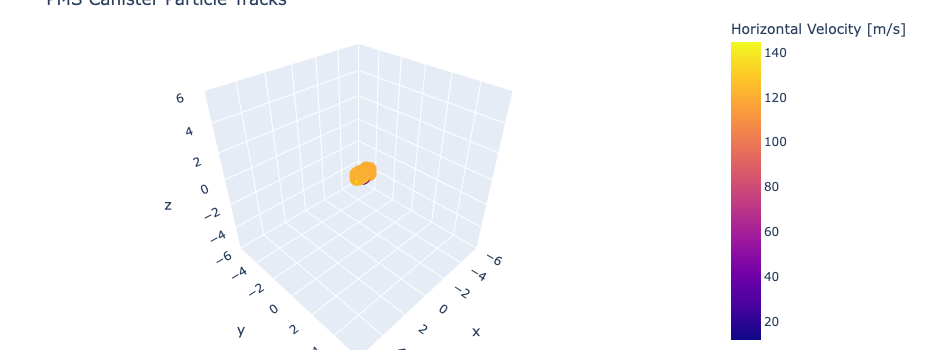

In [14]:
layout2 = go.Layout(width = 700, 
                    title_text='PMS Canister Particle Tracks',
                    scene = dict(xaxis = dict(nticks=9, range=[-6, 6],),
                                 yaxis = dict(nticks=9, range=[-6, 6],),
                                 zaxis = dict(nticks=9, range=[-6, 6],),),
                    margin=dict(r=20, l=10, b=10, t=10))

fig3 = go.Figure(mesh3d, layout = layout2)

fig3.add_scatter3d(x = df2['Points:0'], y = df2['Points:1'], z = df2['Points:2'],
                   mode = 'markers')
fig3.update_traces(marker=dict(color=vel, 
                               showscale=True, 
                               colorbar=dict(title='Horizontal Velocity [m/s]')), 
                   selector=dict(type='scatter3d'))
fig3.show()